# Exploratory Data Analysis of data. 
### Sebastián Andrés Cajas Ordóñez
### Kaggle Username: SEBASTIÁN CAJAS
### NeptunID: RK9KJV


In [53]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import copy
import seaborn as sns
# Analyse missing data
import missingno as msno
# Models
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree   import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import StackingClassifier
from sklearn.naive_bayes import GaussianNB
# Metrics
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.datasets import make_classification
# compare standalone models for binary classification
from numpy import mean
from numpy import std
from matplotlib import pyplot
# Cross-validation
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score


### Read the data files. 
In order to keep these notebooks organized, I will save this data locally within the same folder directory and then I will save the data-engineered data onto a folder called "data", which will store the cleaned data.

In [54]:
X = pd.read_csv('x_train.csv')
y = pd.read_csv('y_train.csv')
x_testing = pd.read_csv('x_test.csv')

In [55]:
X = X[X.columns[1:]]
X.columns = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points', 'Wilderness_Area_1', 'Wilderness_Area_2', 'Wilderness_Area_3', 'Wilderness_Area_4', 
'Soil_Type_1', 'Soil_Type_2','Soil_Type_3','Soil_Type_4','Soil_Type_5','Soil_Type_6','Soil_Type_7','Soil_Type_8','Soil_Type_9','Soil_Type_10',
'Soil_Type_11','Soil_Type_12','Soil_Type_13','Soil_Type_14','Soil_Type_15','Soil_Type_16','Soil_Type_17','Soil_Type_18','Soil_Type_19','Soil_Type_20',
'Soil_Type_21','Soil_Type_22','Soil_Type_23','Soil_Type_24','Soil_Type_25','Soil_Type_26','Soil_Type_27','Soil_Type_28','Soil_Type_29','Soil_Type_30',
'Soil_Type_31','Soil_Type_32','Soil_Type_33','Soil_Type_34','Soil_Type_35','Soil_Type_36','Soil_Type_37','Soil_Type_38','Soil_Type_39','Soil_Type_40']

y = y[y.columns[1:]]
y.columns=['Cover_Type']

# for testing the models
x_testing = x_testing[x_testing.columns[1:]]
x_testing.columns = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points', 'Wilderness_Area_1', 'Wilderness_Area_2', 'Wilderness_Area_3', 'Wilderness_Area_4', 
'Soil_Type_1', 'Soil_Type_2','Soil_Type_3','Soil_Type_4','Soil_Type_5','Soil_Type_6','Soil_Type_7','Soil_Type_8','Soil_Type_9','Soil_Type_10',
'Soil_Type_11','Soil_Type_12','Soil_Type_13','Soil_Type_14','Soil_Type_15','Soil_Type_16','Soil_Type_17','Soil_Type_18','Soil_Type_19','Soil_Type_20',
'Soil_Type_21','Soil_Type_22','Soil_Type_23','Soil_Type_24','Soil_Type_25','Soil_Type_26','Soil_Type_27','Soil_Type_28','Soil_Type_29','Soil_Type_30',
'Soil_Type_31','Soil_Type_32','Soil_Type_33','Soil_Type_34','Soil_Type_35','Soil_Type_36','Soil_Type_37','Soil_Type_38','Soil_Type_39','Soil_Type_40']


We can check that the sizes are correct: we count with 54 attributes and a last one which corresponds to the labering classes.

In [56]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 406708 entries, 0 to 406707
Data columns (total 54 columns):
 #   Column                              Non-Null Count   Dtype
---  ------                              --------------   -----
 0   Elevation                           406708 non-null  int64
 1   Aspect                              406708 non-null  int64
 2   Slope                               406708 non-null  int64
 3   Horizontal_Distance_To_Hydrology    406708 non-null  int64
 4   Vertical_Distance_To_Hydrology      406708 non-null  int64
 5   Horizontal_Distance_To_Roadways     406708 non-null  int64
 6   Hillshade_9am                       406708 non-null  int64
 7   Hillshade_Noon                      406708 non-null  int64
 8   Hillshade_3pm                       406708 non-null  int64
 9   Horizontal_Distance_To_Fire_Points  406708 non-null  int64
 10  Wilderness_Area_1                   406708 non-null  int64
 11  Wilderness_Area_2                   406708 non-null 

Let's check if is there any missing data

In [57]:
X.isnull().sum()

Elevation                             0
Aspect                                0
Slope                                 0
Horizontal_Distance_To_Hydrology      0
Vertical_Distance_To_Hydrology        0
Horizontal_Distance_To_Roadways       0
Hillshade_9am                         0
Hillshade_Noon                        0
Hillshade_3pm                         0
Horizontal_Distance_To_Fire_Points    0
Wilderness_Area_1                     0
Wilderness_Area_2                     0
Wilderness_Area_3                     0
Wilderness_Area_4                     0
Soil_Type_1                           0
Soil_Type_2                           0
Soil_Type_3                           0
Soil_Type_4                           0
Soil_Type_5                           0
Soil_Type_6                           0
Soil_Type_7                           0
Soil_Type_8                           0
Soil_Type_9                           0
Soil_Type_10                          0
Soil_Type_11                          0


From here we can realize that there is not missing data. We can also plot the missing data using msno:

<AxesSubplot:>

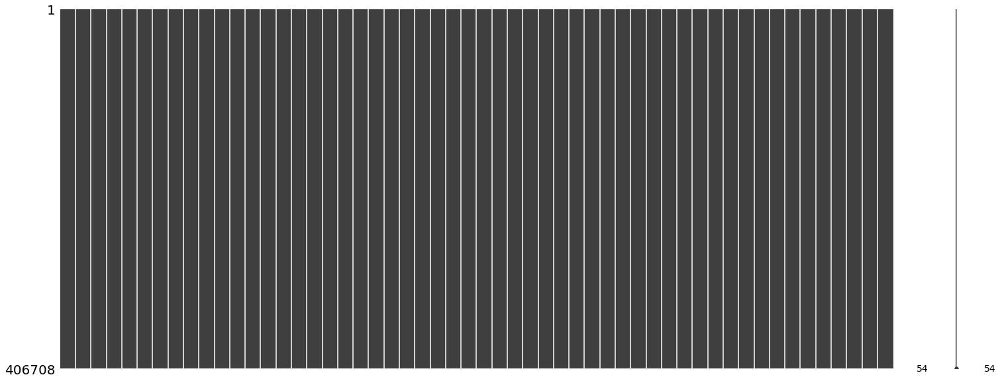

In [58]:
msno.matrix(msno.nullity_sort(X, sort='descending'))

And from here we can verify that there is not missing data at all.

Conducting EDA to understand our data, lets join our target labeling or classification into the training data to try to find patterns or relationships between the variables.

In [59]:
X["target"] = y
X.groupby('target').count()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type_31,Soil_Type_32,Soil_Type_33,Soil_Type_34,Soil_Type_35,Soil_Type_36,Soil_Type_37,Soil_Type_38,Soil_Type_39,Soil_Type_40
target,,,,,,,,,,,,,,,,,,,,,
1,148288,148288,148288,148288,148288,148288,148288,148288,148288,148288,...,148288,148288,148288,148288,148288,148288,148288,148288,148288,148288
2,198310,198310,198310,198310,198310,198310,198310,198310,198310,198310,...,198310,198310,198310,198310,198310,198310,198310,198310,198310,198310
3,25028,25028,25028,25028,25028,25028,25028,25028,25028,25028,...,25028,25028,25028,25028,25028,25028,25028,25028,25028,25028
4,1923,1923,1923,1923,1923,1923,1923,1923,1923,1923,...,1923,1923,1923,1923,1923,1923,1923,1923,1923,1923
5,6645,6645,6645,6645,6645,6645,6645,6645,6645,6645,...,6645,6645,6645,6645,6645,6645,6645,6645,6645,6645
6,12157,12157,12157,12157,12157,12157,12157,12157,12157,12157,...,12157,12157,12157,12157,12157,12157,12157,12157,12157,12157
7,14357,14357,14357,14357,14357,14357,14357,14357,14357,14357,...,14357,14357,14357,14357,14357,14357,14357,14357,14357,14357


<AxesSubplot:xlabel='target', ylabel='count'>

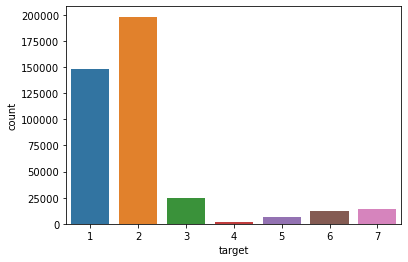

In [60]:
sns.countplot(X['target'])

Text(0.5, 0, 'Target')

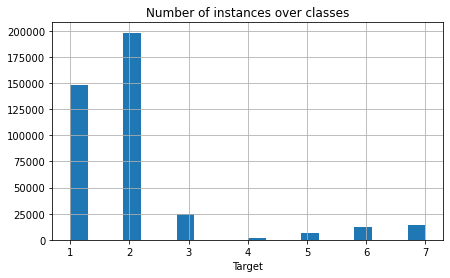

In [61]:
plt.figure(figsize=(7,4))
X['target'].hist(bins=20)
plt.title("Number of instances over classes")
plt.xlabel("Target")

Data labels are not completely balanced, class 1 and 2 are much more abundant over the dataset. Something that can easily be seen is that class 1 and 2 have a very large Elevation, Slope and aspect, indicating that this features might have a strong corrrelation  to these types of classes classification, but it can be seen from the previous table, the number of instances over the entire dataset is also bigger, showing that the data is not fully balanced, so it would explain why this two classes are much strongly present. The only exception this problem would be on the number of ocurrences over class 6 and 7, since the number of classes is similar as shown on class 1 and 2 over distances, elevation, aspect, slope, distance to hydrology and soiltypes.

In [62]:
a = X[['target', 'Elevation','Aspect', 'Slope']].groupby('target').count().reset_index()
a

,target,Elevation,Aspect,Slope
0,1,148288,148288,148288
1,2,198310,198310,198310
2,3,25028,25028,25028
3,4,1923,1923,1923
4,5,6645,6645,6645
5,6,12157,12157,12157
6,7,14357,14357,14357


This function detects first and third quartile and interquartile range for a given column of a dataframe then calculates upper and lower limits to determine outliers conservatively
    returns the number of lower and uper limit and number of outliers respectively

The quartiles divide the data into 4 equal regions. Instead of dividing by 100 in step 2, divide by 4.

Note: The 2nd quartile is the same as the median. The 1st quartile is the 25th percentile, the 3rd quartile is the 75th percentile.

The quartiles are commonly used (much more so than the percentiles or deciles). The TI-82 calculator will find the quartiles for you. Some textbooks include the quartiles in the five number summary.

Ref: https://people.richland.edu/james/lecture/m170/ch03-pos.html
    

In [63]:
def outlier_function(df, col_name):
    # Find percentil for 25 over the 
    first_quartile = np.percentile(np.array(df[col_name].tolist()), 25)
    third_quartile = np.percentile(np.array(df[col_name].tolist()), 75)
    IQR = third_quartile - first_quartile
                      
    upper_limit = third_quartile+(3*IQR)
    lower_limit = first_quartile-(3*IQR)
    outlier_count = 0
                      
    for value in df[col_name].tolist():
        if (value < lower_limit) | (value > upper_limit):
            outlier_count +=1
    return lower_limit, upper_limit, outlier_count

In [64]:
for column in X.columns:
    if outlier_function(X, column)[2] > 0:
        print("There are {} outliers in {}".format(outlier_function(X, column)[2], column))

There are 189 outliers in Slope
There are 199 outliers in Horizontal_Distance_To_Hydrology
There are 3729 outliers in Vertical_Distance_To_Hydrology
There are 727 outliers in Hillshade_9am
There are 835 outliers in Hillshade_Noon
There are 7 outliers in Horizontal_Distance_To_Fire_Points
There are 20979 outliers in Wilderness_Area_2
There are 25874 outliers in Wilderness_Area_4
There are 2113 outliers in Soil_Type_1
There are 5284 outliers in Soil_Type_2
There are 3370 outliers in Soil_Type_3
There are 8732 outliers in Soil_Type_4
There are 1107 outliers in Soil_Type_5
There are 4633 outliers in Soil_Type_6
There are 69 outliers in Soil_Type_7
There are 127 outliers in Soil_Type_8
There are 810 outliers in Soil_Type_9
There are 22805 outliers in Soil_Type_10
There are 8616 outliers in Soil_Type_11
There are 20900 outliers in Soil_Type_12
There are 12226 outliers in Soil_Type_13
There are 420 outliers in Soil_Type_14
There are 2 outliers in Soil_Type_15
There are 2001 outliers in Soil_T

In [65]:
display(X.describe())

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type_32,Soil_Type_33,Soil_Type_34,Soil_Type_35,Soil_Type_36,Soil_Type_37,Soil_Type_38,Soil_Type_39,Soil_Type_40,target
count,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,...,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000,406708.000000
mean,2959.329730,155.763309,14.103413,269.485181,46.467994,2349.097488,212.107827,223.335543,142.593190,1979.708533,...,0.090382,0.077468,0.002801,0.003236,0.000224,0.000548,0.026926,0.023734,0.015139,2.051472
std,280.028028,111.925462,7.490411,212.462577,58.327213,1559.559608,26.785128,19.777075,38.269583,1323.353986,...,0.286728,0.267333,0.052846,0.056792,0.014957,0.023410,0.161867,0.152221,0.122104,1.396507
min,1859.000000,0.000000,0.000000,0.000000,-173.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2809.000000,58.000000,9.000000,108.000000,7.000000,1103.000000,198.000000,213.000000,119.000000,1024.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,2995.000000,127.000000,13.000000,218.000000,30.000000,1994.000000,218.000000,226.000000,143.000000,1710.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,3163.000000,261.000000,18.000000,390.000000,69.000000,3328.000000,231.000000,237.000000,168.000000,2550.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
max,3858.000000,360.000000,66.000000,1397.000000,599.000000,7117.000000,254.000000,254.000000,254.000000,7173.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


From here we can see the next intervals: 


Elevation:  1859- 3858 = 1999

Aspect:	0,360 = 360

Slope: 0, 66 =66

Horizontal_Distance_To_Hydrology: 0, 1397 = 1397

Vertical_Distance_To_Hydrology: -173, 599 = 426

Horizontal_Distance_To_Roadways: 0, 7117 = 7117

Horizaontal_Distance_To_Firepoints: 0, 7173 = 7173

Hillshade_9am: 0,254

Hillshade_Noon: 0,254

Hillshade_3pm: 0, 254

Soil_Types : 0,50

So from here we can see that the columns with the highest number of points or data are Horizontal_Distance_To_Roadways and Horizaontal_Distance_To_Firepoints

In [66]:
X_cp = X.copy()
# Horizontal_Distance_To_Fire_Points

X_cp = X_cp[(X_cp['Horizontal_Distance_To_Fire_Points'] > outlier_function(X_cp, 'Horizontal_Distance_To_Fire_Points')[0]) &
              (X_cp['Horizontal_Distance_To_Fire_Points'] < outlier_function(X_cp, 'Horizontal_Distance_To_Fire_Points')[1])]
# Horizontal_Distance_To_Roadways
X_cp = X_cp[(X_cp['Horizontal_Distance_To_Roadways'] > outlier_function(X_cp, 'Horizontal_Distance_To_Roadways')[0]) &
              (X_cp['Horizontal_Distance_To_Roadways'] < outlier_function(X_cp, 'Horizontal_Distance_To_Roadways')[1])]
X_cp.shape

(406701, 55)

In [67]:
X.shape

(406708, 55)

Now we have 406701, before 406708, so there was not too much change since the data seems to be without many outliers

In [68]:
# list of columns of wilderness areas and soil types and verify they are hot-encoded anc therefore contain only 0 and 1
is_binary_columns = [column for column in X.columns if ("Wilderness" in column) | ("Soil" in column)]
pd.unique(X[is_binary_columns].values.ravel())

array([0, 1], dtype=int64)

<AxesSubplot:xlabel='target'>

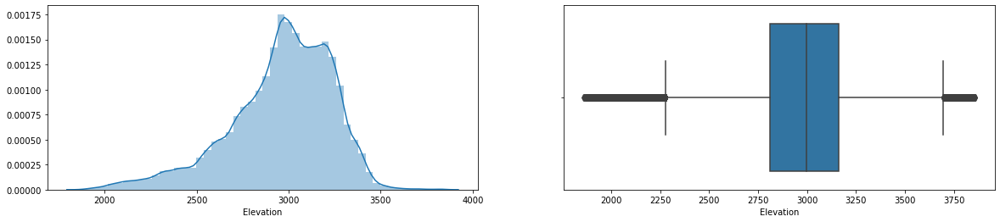

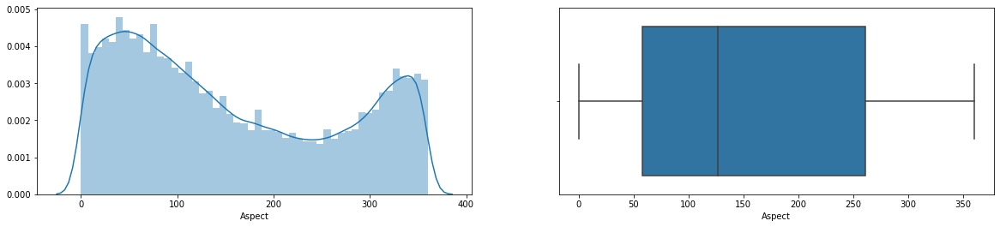

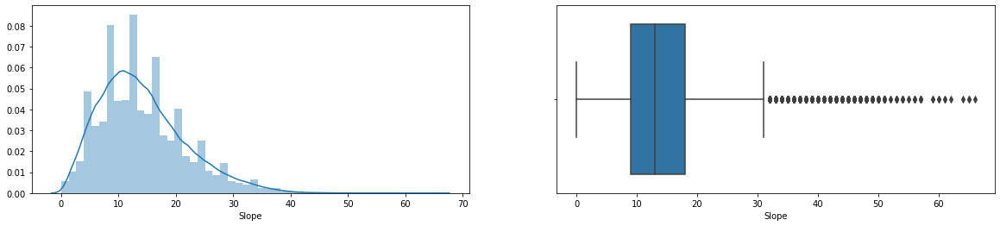

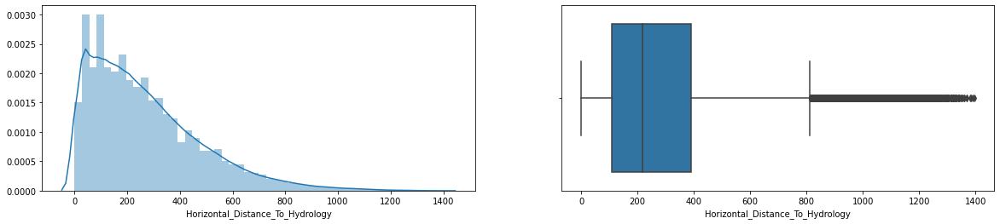

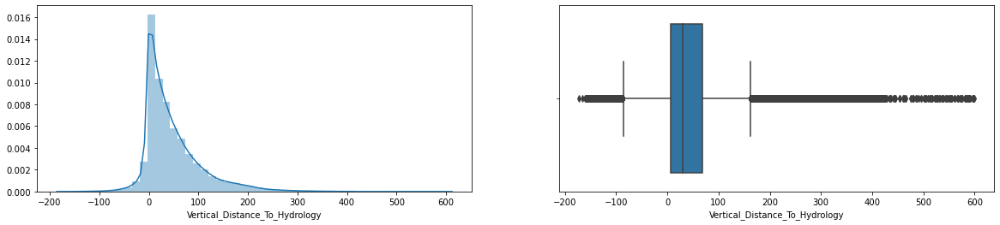

...

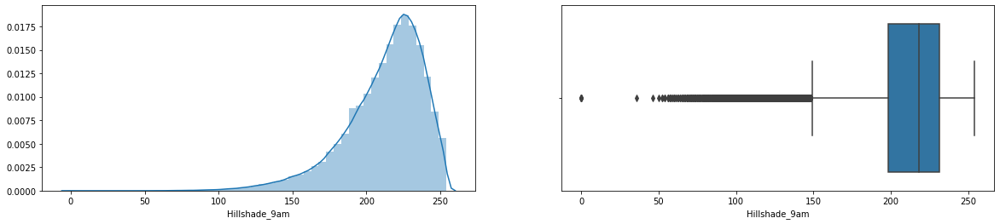

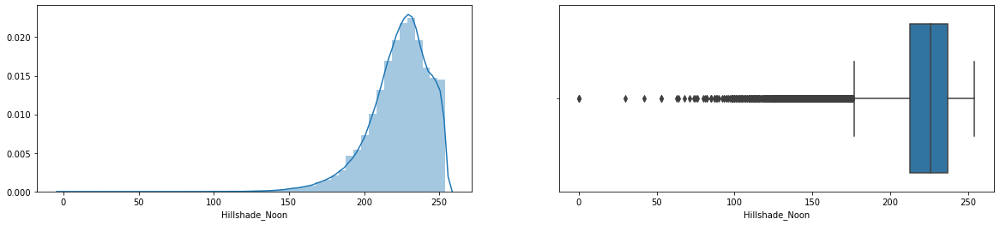

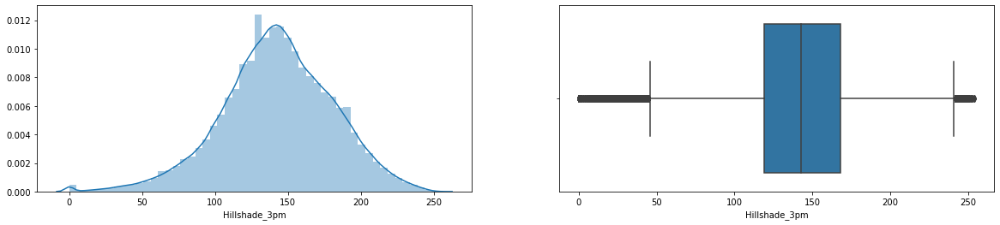

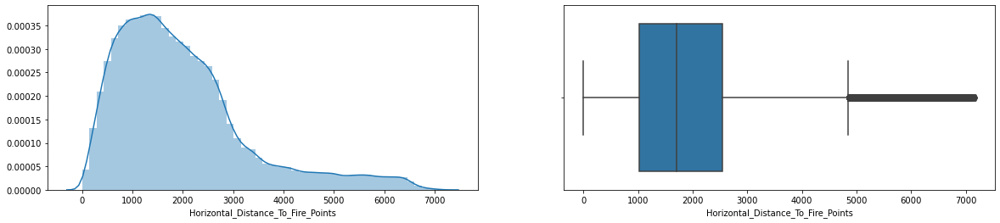

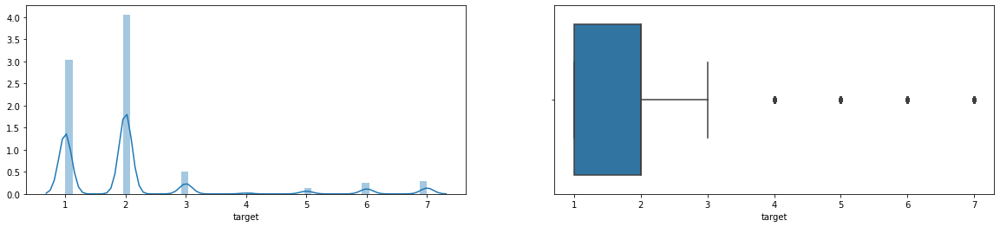

In [69]:
f = plt.figure(figsize=(20,4))
f.add_subplot(1,2,1)
sns.distplot(X['Elevation'])
f.add_subplot(1,2,2)
sns.boxplot(X['Elevation'])

f1 = plt.figure(figsize=(20,4))
f1.add_subplot(1,2,1)
sns.distplot(X['Aspect'])
f1.add_subplot(1,2,2)
sns.boxplot(X['Aspect'])


f2 = plt.figure(figsize=(20,4))
f2.add_subplot(1,2,1)
sns.distplot(X['Slope'])
f2.add_subplot(1,2,2)
sns.boxplot(X['Slope'])

f3 = plt.figure(figsize=(20,4))
f3.add_subplot(1,2,1)
sns.distplot(X['Horizontal_Distance_To_Hydrology'])
f3.add_subplot(1,2,2)
sns.boxplot(X['Horizontal_Distance_To_Hydrology'])


f4 = plt.figure(figsize=(20,4))
f4.add_subplot(1,2,1)
sns.distplot(X['Vertical_Distance_To_Hydrology'])
f4.add_subplot(1,2,2)
sns.boxplot(X['Vertical_Distance_To_Hydrology'])


f5 = plt.figure(figsize=(20,4))
f5.add_subplot(1,2,1)
sns.distplot(X['Horizontal_Distance_To_Roadways'])
f5.add_subplot(1,2,2)
sns.boxplot(X['Horizontal_Distance_To_Roadways'])

f6 = plt.figure(figsize=(20,4))
f6.add_subplot(1,2,1)
sns.distplot(X['Hillshade_9am'])
f6.add_subplot(1,2,2)
sns.boxplot(X['Hillshade_9am'])

f7 = plt.figure(figsize=(20,4))
f7.add_subplot(1,2,1)
sns.distplot(X['Hillshade_Noon'])
f7.add_subplot(1,2,2)
sns.boxplot(X['Hillshade_Noon'])

f8 = plt.figure(figsize=(20,4))
f8.add_subplot(1,2,1)
sns.distplot(X['Hillshade_3pm'])
f8.add_subplot(1,2,2)
sns.boxplot(X['Hillshade_3pm'])

f9 = plt.figure(figsize=(20,4))
f9.add_subplot(1,2,1)
sns.distplot(X['Horizontal_Distance_To_Fire_Points'])
f9.add_subplot(1,2,2)
sns.boxplot(X['Horizontal_Distance_To_Fire_Points'])

f10 = plt.figure(figsize=(20,4))
f10.add_subplot(1,2,1)
sns.distplot(X['target'])
f10.add_subplot(1,2,2)
sns.boxplot(X['target'])

#### Compacting soil types. 
We drop the target label again with the aim of transforming data into a more compact way.

### Convert hot-encode format to integer or numerical values
Alternative method Now sum up soil types, since they are  hot-encoded the result will be just an integer


Generalized method for convertion of hot-encode to integer

In [70]:
def split_numbers_chars(row):
    head = row.rstrip('0123456789')
    tail = row[len(head):]
    return head, tail

def reverse_one_hot_encode(dataframe, start_loc, end_loc, numeric_column_name):
    dataframe['String_Column'] = (dataframe.iloc[:, start_loc:end_loc] == 1).idxmax(1)
    dataframe['Tuple_Column'] = dataframe['String_Column'].apply(split_numbers_chars)
    dataframe[numeric_column_name] = dataframe['Tuple_Column'].apply(lambda x: x[1]).astype('int64')
    dataframe.drop(columns=['String_Column','Tuple_Column'], inplace=True)

Convert Soil types and wilderness areas to integers

In [71]:
reverse_one_hot_encode(X, 14, 53, "Soil_type")
reverse_one_hot_encode(x_testing, 14, 53, "Soil_type")
reverse_one_hot_encode(X, 10, 13, "Wilderness_area")
reverse_one_hot_encode(x_testing, 10, 13, "Wilderness_area")

In [72]:
fields = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points', "Wilderness_area","Soil_type"]
X_1 = X[fields]
x_1_testing = x_testing[fields]
X_1.groupby('Wilderness_area').count()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,Soil_type
Wilderness_area,,,,,,,,,,,
1,208520,208520,208520,208520,208520,208520,208520,208520,208520,208520,208520
2,20979,20979,20979,20979,20979,20979,20979,20979,20979,20979,20979
3,177209,177209,177209,177209,177209,177209,177209,177209,177209,177209,177209


In [73]:
X_1.groupby('Soil_type').count().head(4)

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,Wilderness_area
Soil_type,,,,,,,,,,,
1,8270,8270,8270,8270,8270,8270,8270,8270,8270,8270,8270
2,5284,5284,5284,5284,5284,5284,5284,5284,5284,5284,5284
3,3370,3370,3370,3370,3370,3370,3370,3370,3370,3370,3370
4,8732,8732,8732,8732,8732,8732,8732,8732,8732,8732,8732


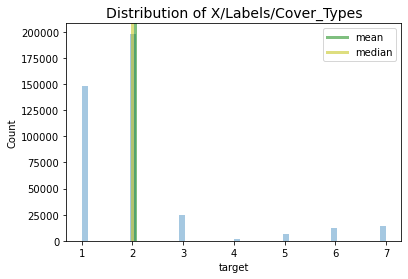

In [74]:
# set the plot size
figsize=(14,10)

# set the histogram, mean and median
sns.distplot(X["target"], kde=False)
plt.axvline(x=X.target.mean(), linewidth=3, color='g', label="mean", alpha=0.5)
plt.axvline(x=X.target.median(), linewidth=3, color='y', label="median", alpha=0.5)

# set title, legends and labels
plt.xlabel("target")
plt.ylabel("Count")
plt.title("Distribution of X/Labels/Cover_Types", size=14)
plt.legend(["mean", "median"])

In [75]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 406708 entries, 0 to 406707
Data columns (total 57 columns):
 #   Column                              Non-Null Count   Dtype
---  ------                              --------------   -----
 0   Elevation                           406708 non-null  int64
 1   Aspect                              406708 non-null  int64
 2   Slope                               406708 non-null  int64
 3   Horizontal_Distance_To_Hydrology    406708 non-null  int64
 4   Vertical_Distance_To_Hydrology      406708 non-null  int64
 5   Horizontal_Distance_To_Roadways     406708 non-null  int64
 6   Hillshade_9am                       406708 non-null  int64
 7   Hillshade_Noon                      406708 non-null  int64
 8   Hillshade_3pm                       406708 non-null  int64
 9   Horizontal_Distance_To_Fire_Points  406708 non-null  int64
 10  Wilderness_Area_1                   406708 non-null  int64
 11  Wilderness_Area_2                   406708 non-null 

In [82]:
X

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type_34,Soil_Type_35,Soil_Type_36,Soil_Type_37,Soil_Type_38,Soil_Type_39,Soil_Type_40,target,Soil_type,Wilderness_area
0,3342,15,13,350,55,2118,208,212,139,1486,...,0,0,0,0,0,0,0,1,31,3
1,2764,39,13,175,43,2648,220,210,122,366,...,0,0,0,0,0,0,0,2,10,3
2,2773,158,5,162,14,2012,226,241,149,967,...,0,0,0,0,0,0,0,2,12,1
3,3083,108,16,30,-14,2639,246,220,98,1909,...,0,0,0,0,0,0,0,1,31,3
4,3096,40,4,201,38,4592,220,231,147,2432,...,0,0,0,0,0,0,0,1,29,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
406703,3066,133,10,170,30,1455,237,235,128,2624,...,0,0,0,0,0,0,0,2,29,1
406704,2308,37,31,162,38,616,202,156,71,895,...,0,0,0,0,0,0,0,6,10,4
406705,2715,73,32,342,188,1027,237,162,31,953,...,0,0,0,0,0,0,0,2,33,3
406706,3020,179,13,170,19,1471,225,247,152,450,...,0,0,0,0,0,0,0,2,13,3


Text(0.5, 1.0, 'Density of Cover Types Among Different Wilderness Areas')

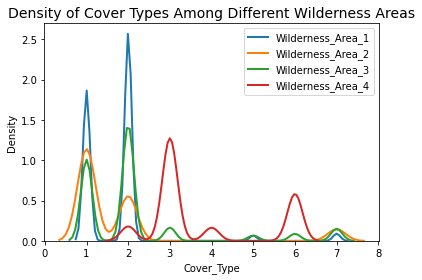

In [78]:
# Create one column as Wilderness_Area_Type and represent it as categorical data
X['target'] = y
X['Wilderness_area'] = (X.iloc[:, 10:14] == 1).idxmax(1)
# For testing set:
x_testing['Wilderness_area'] = (x_testing.iloc[:, 10:13] == 1).idxmax(1)

#list of wilderness areas
wilderness_areas = sorted(X['Wilderness_area'].value_counts().index.tolist())

# distribution of the cover type in different wilderness areas
figsize=(14,10)

# plot cover_type distribution for each wilderness area
for area in wilderness_areas:
    subset = X[X['Wilderness_area'] == area]
    sns.kdeplot(subset["target"], label=area, linewidth=2)

# set title, legends and labels
plt.ylabel("Density")
plt.xlabel("Cover_Type")
plt.title("Density of Cover Types Among Different Wilderness Areas", size=14)

Convert the wilderness area values into integers 1-4 for easier analysis and computation, since later we would like to make some data transformation to see if it could improve our model performance.

In [83]:
X.loc[X['Wilderness_area'] == 'Wilderness_Area_1', 'Wilderness_area'] = 1
X.loc[X['Wilderness_area'] == 'Wilderness_Area_2', 'Wilderness_area'] = 2
X.loc[X['Wilderness_area'] == 'Wilderness_Area_3', 'Wilderness_area'] = 3
X.loc[X['Wilderness_area'] == 'Wilderness_Area_4', 'Wilderness_area'] = 4
X['Wilderness_area']= X['Wilderness_area'].astype('int64')


Similar procedure is performed over the testing data

In [84]:
# for testing
x_testing.loc[x_testing['Wilderness_area'] == 'Wilderness_Area_1', 'Wilderness_area'] = 1
x_testing.loc[x_testing['Wilderness_area'] == 'Wilderness_Area_2', 'Wilderness_area'] = 2
x_testing.loc[x_testing['Wilderness_area'] == 'Wilderness_Area_3', 'Wilderness_area'] = 3
x_testing.loc[x_testing['Wilderness_area'] == 'Wilderness_Area_4', 'Wilderness_area'] = 4
x_testing['Wilderness_area']= x_testing['Wilderness_area'].astype('int64')

Text(0.5, 1.05, 'Pearson Correlation of All Features')

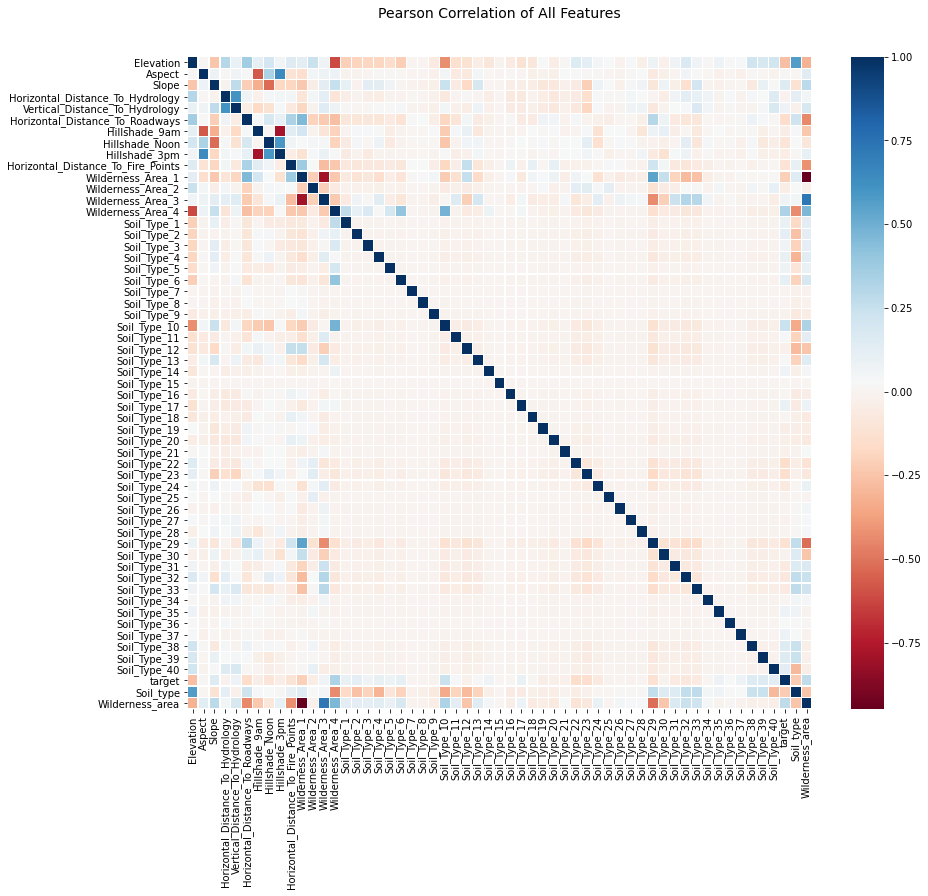

In [85]:
plt.figure(figsize=(14,12))

# plot heatmap set the title
colormap = plt.cm.RdBu
sns.heatmap(X.corr(),linewidths=0.1,vmax=1.0, 
            square=False, cmap=colormap, linecolor='white', annot=False)
plt.title('Pearson Correlation of All Features', y=1.05, size=14)

Considering all the variables, we can see that the soil type has higher correlation with other variables with it is compacted into a single column, as well as the wilderness area, therefore I will make a cut again to check this correlation diagram closer.

Text(0.5, 1.05, 'Pearson Correlation of All Features')

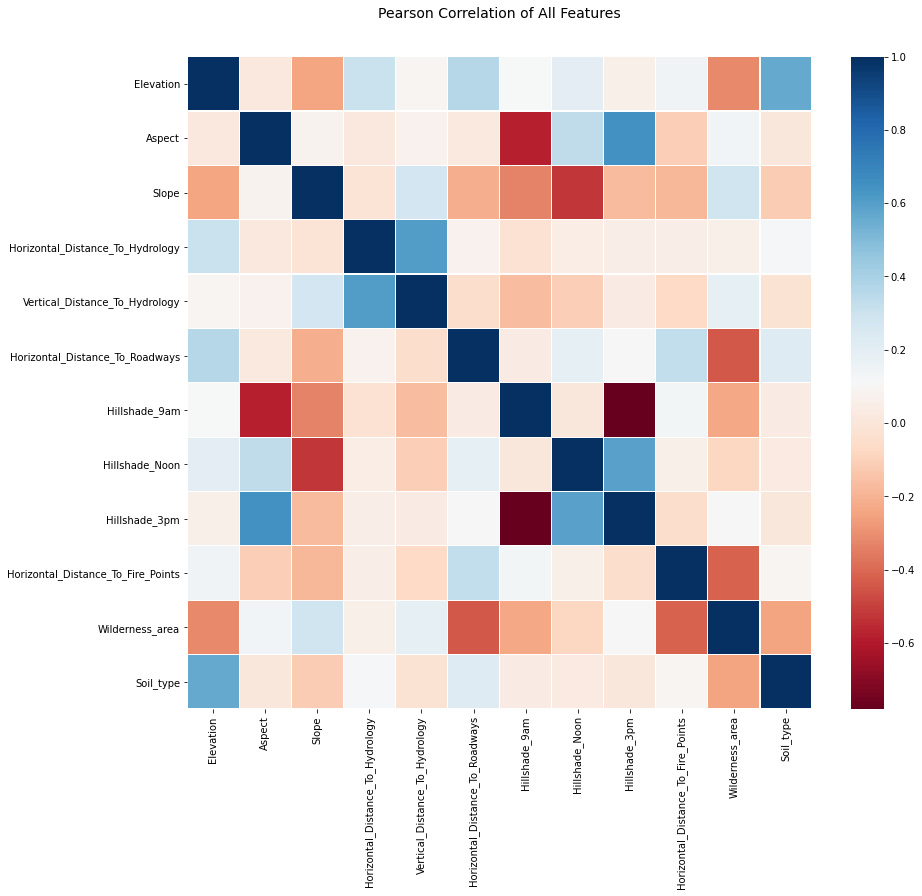

In [87]:
fields = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points', "Wilderness_area","Soil_type"]
X_1 = X[fields]
x_1_testing = x_testing[fields]
plt.figure(figsize=(14,12))

# plot heatmap set the title
colormap = plt.cm.RdBu
sns.heatmap(X_1.corr(),linewidths=0.1,vmax=1.0, 
            square=False, cmap=colormap, linecolor='white', annot=False)
plt.title('Pearson Correlation of All Features', y=1.05, size=14)

Let's extract the continuous variables

In [88]:
# store continious variables in a list
continuous_variables = X.columns[0:10].tolist()

# Function to calculate correlation coefficient between two columns
def corr_func(x, y, **kwargs):
    r = np.corrcoef(x, y)[0][1]
    ax = plt.gca()
    ax.annotate("r = {:.2f}".format(r),
                xy=(.2, .8), xycoords=ax.transAxes,
                size = 20)
continuous_variables

['Elevation',
 'Aspect',
 'Slope',
 'Horizontal_Distance_To_Hydrology',
 'Vertical_Distance_To_Hydrology',
 'Horizontal_Distance_To_Roadways',
 'Hillshade_9am',
 'Hillshade_Noon',
 'Hillshade_3pm',
 'Horizontal_Distance_To_Fire_Points']

In [93]:
continuous_variables

['Elevation',
 'Aspect',
 'Slope',
 'Horizontal_Distance_To_Hydrology',
 'Vertical_Distance_To_Hydrology',
 'Horizontal_Distance_To_Roadways',
 'Hillshade_9am',
 'Hillshade_Noon',
 'Hillshade_3pm',
 'Horizontal_Distance_To_Fire_Points']

Text(0.5, 1.0, 'Pearson Correlation of Features with Numeric Soil_Type')

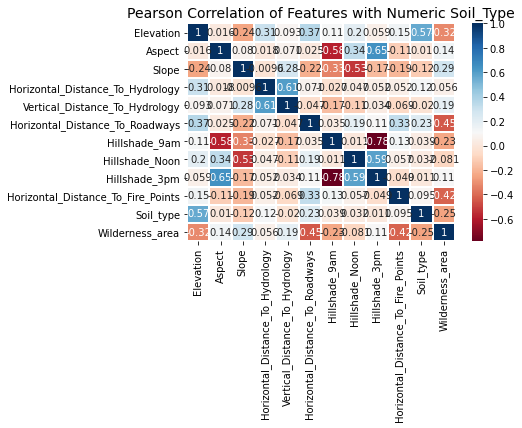

In [101]:
# make a list of numeric features and create a dataframe with them
all_features_w_label = continuous_variables  + ["Soil_type"] + ["Wilderness_area"]
trees_w_numeric_soil = X_1[all_features_w_label]
# for testing set
trees_w_numeric_soil_testing = x_1_testing[all_features_w_label]

# pearson coefficients with numeric soil type column
correlations = pd.DataFrame(trees_w_numeric_soil.corr())

figsize=(20,20)

# plot the heatmap
colormap = plt.cm.RdBu
sns.heatmap(correlations,linewidths=0.9, 
            square=False, cmap=colormap, linecolor='white', annot=True)
plt.title('Pearson Correlation of Features with Numeric Soil_Type', size=14)

In [102]:
trees_w_numeric_soil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 406708 entries, 0 to 406707
Data columns (total 12 columns):
 #   Column                              Non-Null Count   Dtype
---  ------                              --------------   -----
 0   Elevation                           406708 non-null  int64
 1   Aspect                              406708 non-null  int64
 2   Slope                               406708 non-null  int64
 3   Horizontal_Distance_To_Hydrology    406708 non-null  int64
 4   Vertical_Distance_To_Hydrology      406708 non-null  int64
 5   Horizontal_Distance_To_Roadways     406708 non-null  int64
 6   Hillshade_9am                       406708 non-null  int64
 7   Hillshade_Noon                      406708 non-null  int64
 8   Hillshade_3pm                       406708 non-null  int64
 9   Horizontal_Distance_To_Fire_Points  406708 non-null  int64
 10  Soil_type                           406708 non-null  int64
 11  Wilderness_area                     406708 non-null 

In [103]:
trees_w_numeric_soil.columns

Index(['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points', 'Soil_type', 'Wilderness_area'],
      dtype='object')

So until here we can see that there is a high correlation between Hillshade at 9 am and at 3 pm, so in this particular case I actually tested this features with the KNN model as a reference to hypertune and analyze whether these change on the variables were affecting my model performance, so I tool the following attributes only: features_not_correlated = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points', 'Soil_type', 'Wilderness_area'] and used KNN with euclidean distance (p) equal to 1, leafs = 1 and 3 neighbors. Which yielded an accuracy of 96.69 using 10-fold cross validation.

In [115]:
features_not_correlated = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points', 'Soil_type', 'Wilderness_area']
trees_w_numeric_soil = trees_w_numeric_soil[features_not_correlated]
trees_w_numeric_soil_testing = trees_w_numeric_soil_testing[features_not_correlated]
print(trees_w_numeric_soil.shape)
print(trees_w_numeric_soil_testing.shape)

In [113]:

transformed_features = ['sqrtHorizontal_Distance_To_Hydrology', 'sqrtMean_Distance_Hydrology_Roadways', 'sqrtEuclidian_Distance_To_Hydrology', 
                        'Mean_Elevation_Vertical_Distance_Hydrology', 'Mean_Distance_Firepoints_Roadways', 'Mean_Distance_Hydrology_Firepoints',  ]

all_features =  (['Elevation', 'Aspect', 'Slope', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points' ] + wilderness_areas +
                 ['Soil_type'] + transformed_features)
features_not_correlated = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points', 'Soil_type', 'Wilderness_area']
X_1 = trees_w_numeric_soil[features_not_correlated]
x_testing_1 = trees_w_numeric_soil_testing[features_not_correlated]
# Cleaned
X_1.to_csv('X_cleaned.csv', sep='|', index=False)
x_testing_1.to_csv('X_testing.csv', sep='|', index=False)
y.to_csv('y_cleaned.csv',sep='|',index=False)
# Original
X.to_csv('X_original_fixed.csv', sep='|', index=False)
x_testing.to_csv('X_testing_original_fixed.csv', sep='|', index=False)
y.to_csv('y_original_fixed.csv',sep='|',index=False)
print("Cleaned data is saved")

Cleaned data is saved


This shows that certain cover types can be found with some especific wilderness areas, therefore this is an important feature

# Feature engineering 

In [117]:
trees_w_numeric_soil.columns

Index(['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points',
       'Soil_type', 'Wilderness_area'],
      dtype='object')

The euclidean distance to hydrology is described here, the idea is to use the variables of the vertical and horizontal attributes to perform a data transformation, which is the distance from the selected point and the hydrologic section instead of the other variables. 

In [119]:
## For the training data:
# Euclidean distance
trees_w_numeric_soil['Euclidian_Distance_To_Hydrology'] = (trees_w_numeric_soil['Horizontal_Distance_To_Hydrology']**2 +trees_w_numeric_soil['Vertical_Distance_To_Hydrology']**2)**0.5
# Mean elevation to vertical-hydrology
trees_w_numeric_soil['Mean_Elevation_Vertical_Distance_Hydrology'] = (trees_w_numeric_soil['Elevation'] +trees_w_numeric_soil['Vertical_Distance_To_Hydrology'])/2

# Mean between horizontal distance to hydrology and firepoints.
trees_w_numeric_soil['Mean_Distance_Hydrology_Firepoints'] = (trees_w_numeric_soil['Horizontal_Distance_To_Hydrology'] + trees_w_numeric_soil['Horizontal_Distance_To_Fire_Points'])/2
# Mean between Mean_Distance_Hydrology_Roadways and Horizontal_Distance_To_Hydrology
trees_w_numeric_soil['Mean_Distance_Hydrology_Roadways'] = (trees_w_numeric_soil['Horizontal_Distance_To_Hydrology'] + trees_w_numeric_soil['Horizontal_Distance_To_Roadways'])/2
# Mean between Horizontal_Distance_To_Fire_Points and roadways
trees_w_numeric_soil['Mean_Distance_Firepoints_Roadways'] = (trees_w_numeric_soil['Horizontal_Distance_To_Fire_Points'] +trees_w_numeric_soil['Horizontal_Distance_To_Roadways'])/2

# Same procedure for testing set
trees_w_numeric_soil_testing['Euclidian_Distance_To_Hydrology'] = (trees_w_numeric_soil_testing['Horizontal_Distance_To_Hydrology']**2 + trees_w_numeric_soil_testing['Vertical_Distance_To_Hydrology']**2)**0.5

trees_w_numeric_soil_testing['Mean_Elevation_Vertical_Distance_Hydrology'] = (trees_w_numeric_soil_testing['Elevation'] +trees_w_numeric_soil_testing['Vertical_Distance_To_Hydrology'])/2

trees_w_numeric_soil_testing['Mean_Distance_Hydrology_Firepoints'] = (trees_w_numeric_soil_testing['Horizontal_Distance_To_Hydrology'] +  trees_w_numeric_soil_testing['Horizontal_Distance_To_Fire_Points'])/2
trees_w_numeric_soil_testing['Mean_Distance_Hydrology_Roadways'] = (trees_w_numeric_soil_testing['Horizontal_Distance_To_Hydrology'] + trees_w_numeric_soil_testing['Horizontal_Distance_To_Roadways'])/2
trees_w_numeric_soil_testing['Mean_Distance_Firepoints_Roadways'] = (trees_w_numeric_soil_testing['Horizontal_Distance_To_Fire_Points'] + trees_w_numeric_soil_testing['Horizontal_Distance_To_Roadways'])/2


In [120]:
trees_w_numeric_soil.columns

Index(['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points',
       'Soil_type', 'Wilderness_area', 'Euclidian_Distance_To_Hydrology',
       'Mean_Elevation_Vertical_Distance_Hydrology',
       'Mean_Distance_Hydrology_Firepoints',
       'Mean_Distance_Hydrology_Roadways',
       'Mean_Distance_Firepoints_Roadways'],
      dtype='object')

In [124]:
import numpy as np
#trees_w_numeric_soil = X[all_features_w_label]
# add sqrt transformed columns to the trees_w_numeric_soil dataframe
for i,col in enumerate(trees_w_numeric_soil):
    print(i,col)
    if col == 'target':
        next
    else:
        a = pd.to_numeric(trees_w_numeric_soil[col], downcast='float')
        trees_w_numeric_soil["sqrt" + col] = np.sqrt(a)
        # testing set
        b = pd.to_numeric(trees_w_numeric_soil_testing[col], downcast='float')
        trees_w_numeric_soil_testing["sqrt" + col] = np.sqrt(b)
trees_w_numeric_soil

0 Elevation
1 Aspect
2 Slope
3 Horizontal_Distance_To_Hydrology
4 Vertical_Distance_To_Hydrology
5 Horizontal_Distance_To_Roadways
6 Hillshade_Noon
7 Hillshade_3pm
8 Horizontal_Distance_To_Fire_Points
9 Soil_type
10 Wilderness_area
11 Euclidian_Distance_To_Hydrology
12 Mean_Elevation_Vertical_Distance_Hydrology
13 Mean_Distance_Hydrology_Firepoints
14 Mean_Distance_Hydrology_Roadways
15 Mean_Distance_Firepoints_Roadways


,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,Soil_type,...,sqrtHillshade_Noon,sqrtHillshade_3pm,sqrtHorizontal_Distance_To_Fire_Points,sqrtSoil_type,sqrtWilderness_area,sqrtEuclidian_Distance_To_Hydrology,sqrtMean_Elevation_Vertical_Distance_Hydrology,sqrtMean_Distance_Hydrology_Firepoints,sqrtMean_Distance_Hydrology_Roadways,sqrtMean_Distance_Firepoints_Roadways
0,3342,15,13,350,55,2118,212,139,1486,31,...,14.560220,11.789826,38.548672,5.567764,1.732051,18.822727,41.212864,30.298515,35.128338,42.449970
1,2764,39,13,175,43,2648,210,122,366,10,...,14.491377,11.045361,19.131126,3.162278,1.732051,13.424062,37.463314,16.446884,37.569935,38.820099
2,2773,158,5,162,14,2012,241,149,967,12,...,15.524175,12.206555,31.096624,3.464102,1.000000,12.751619,37.329613,23.759209,32.969685,38.594040
3,3083,108,16,30,-14,2639,220,98,1909,31,...,14.832397,9.899495,43.692104,5.567764,1.732051,5.753772,39.172695,31.136795,36.530807,47.686478
4,3096,40,4,201,38,4592,231,147,2432,29,...,15.198684,12.124355,49.315311,5.385165,1.000000,14.302464,39.585350,36.283604,48.954060,59.262131
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
406703,3066,133,10,170,30,1455,235,128,2624,29,...,15.329710,11.313708,51.224995,5.385165,1.000000,13.138751,39.344631,37.376465,28.504385,45.160824
406704,2308,37,31,162,38,616,156,71,895,10,...,12.489996,8.426149,29.916550,3.162278,2.000000,12.899501,34.249088,22.989128,19.723083,27.486361
406705,2715,73,32,342,188,1027,162,31,953,33,...,12.727922,5.567764,30.870699,5.744563,1.732051,19.755165,38.098557,25.446022,26.162951,31.464266
406706,3020,179,13,170,19,1471,247,152,450,13,...,15.716233,12.328828,21.213203,3.605551,1.732051,13.078933,38.980766,17.606817,28.644371,30.991934


In [127]:
trees_w_numeric_soil.columns

Index(['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points',
       'Soil_type', 'Wilderness_area', 'Euclidian_Distance_To_Hydrology',
       'Mean_Elevation_Vertical_Distance_Hydrology',
       'Mean_Distance_Hydrology_Firepoints',
       'Mean_Distance_Hydrology_Roadways', 'Mean_Distance_Firepoints_Roadways',
       'sqrtElevation', 'sqrtAspect', 'sqrtSlope',
       'sqrtHorizontal_Distance_To_Hydrology',
       'sqrtVertical_Distance_To_Hydrology',
       'sqrtHorizontal_Distance_To_Roadways', 'sqrtHillshade_Noon',
       'sqrtHillshade_3pm', 'sqrtHorizontal_Distance_To_Fire_Points',
       'sqrtSoil_type', 'sqrtWilderness_area',
       'sqrtEuclidian_Distance_To_Hydrology',
       'sqrtMean_Elevation_Vertical_Distance_Hydrology',
       'sqrtMean_Distance_Hydrology_Firepoints',
       'sqrtMean_Distance_Hydrology_R

In [325]:

transformed_features = ['sqrtHorizontal_Distance_To_Hydrology', 'sqrtMean_Distance_Hydrology_Roadways', 'sqrtEuclidian_Distance_To_Hydrology', 
                        'Mean_Elevation_Vertical_Distance_Hydrology', 'Mean_Distance_Firepoints_Roadways', 'Mean_Distance_Hydrology_Firepoints',  ]

all_features =  (['Elevation', 'Aspect', 'Slope', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points' ] + wilderness_areas +
                 ['Soil_type'] + transformed_features)

features_not_correlated_part_1 = ['Elevation', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points', 'Soil_type', 'Wilderness_area']
features_not_correlated_part_data_engineering = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Horizontal_Distance_To_Roadways',
       'Hillshade_Noon', 'Hillshade_3pm', 
       'Soil_type', 'Wilderness_area', 
       'Mean_Elevation_Vertical_Distance_Hydrology',
       'Mean_Distance_Hydrology_Firepoints',
       'Mean_Distance_Hydrology_Roadways', 'Mean_Distance_Firepoints_Roadways',
       'sqrtElevation',  'sqrtSlope',
       'sqrtHorizontal_Distance_To_Hydrology',
       'sqrtHorizontal_Distance_To_Roadways', 'sqrtHillshade_Noon',
       'sqrtHillshade_3pm', 'sqrtHorizontal_Distance_To_Fire_Points',
       'sqrtSoil_type', 'sqrtWilderness_area',
       'sqrtEuclidian_Distance_To_Hydrology',
       'sqrtMean_Elevation_Vertical_Distance_Hydrology',
       'sqrtMean_Distance_Hydrology_Firepoints',
       'sqrtMean_Distance_Hydrology_Roadways',
       'sqrtMean_Distance_Firepoints_Roadways']
X_1 = trees_w_numeric_soil[features_not_correlated_part_data_engineering]
x_testing_1 = trees_w_numeric_soil_testing[features_not_correlated_part_data_engineering]
# Cleaned
X_1.to_csv('X_cleaned.csv', sep='|', index=False)
x_testing_1.to_csv('X_testing.csv', sep='|', index=False)
y.to_csv('y_cleaned.csv',sep='|',index=False)
# Original
X.to_csv('X_original_fixed.csv', sep='|', index=False)
x_testing.to_csv('X_testing_original_fixed.csv', sep='|', index=False)
y.to_csv('y_original_fixed.csv',sep='|',index=False)
print("Cleaned data is saved")

(406708, 38)
(406708, 1)
(174304, 38)
(406708, 57)
(406708, 1)
(174304, 56)
saved


In [126]:
correlations_transformed = pd.DataFrame(trees_w_numeric_soil.corr())
trees_w_numeric_soil["target"] = y
correlations_transformed = pd.DataFrame(correlations_transformed["target"]).reset_index()

# format, and display sorted correlations_transformed
correlations_transformed.columns = ["Feature", "Correlation with Cover_Type"]
correlations_transformed = (correlations_transformed[correlations_transformed["Feature"] != "target"].sort_values(by="Correlation with Cover_Type", ascending=True))
display(correlations_transformed)

,Feature,Correlation with Cover_Type
16,sqrtElevation,-0.279948
0,Elevation,-0.268922
25,sqrtSoil_type,-0.267091
28,sqrtMean_Elevation_Vertical_Distance_Hydrology,-0.254387
12,Mean_Elevation_Vertical_Distance_Hydrology,-0.241970
9,Soil_type,-0.223385
31,sqrtMean_Distance_Firepoints_Roadways,-0.185797
30,sqrtMean_Distance_Hydrology_Roadways,-0.165203
15,Mean_Distance_Firepoints_Roadways,-0.163414
21,sqrtHorizontal_Distance_To_Roadways,-0.162499


,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,sqrtWilderness_Area_2,sqrtWilderness_Area_3,sqrtWilderness_Area_4,sqrtSoil_type,sqrtEuclidian_Distance_To_Hydrology,sqrtMean_Elevation_Vertical_Distance_Hydrology,sqrtMean_Distance_Hydrology_Firepoints,sqrtMean_Distance_Hydrology_Roadways,sqrtMean_Distance_Firepoints_Roadways,target
0,3342,15,13,350,55,2118,208,212,139,1486,...,0.0,1.0,0.0,5.567764,18.822727,41.212864,30.298515,35.128338,42.449970,1
1,2764,39,13,175,43,2648,220,210,122,366,...,0.0,1.0,0.0,3.162278,13.424062,37.463314,16.446884,37.569935,38.820099,2
2,2773,158,5,162,14,2012,226,241,149,967,...,0.0,0.0,0.0,3.464102,12.751619,37.329613,23.759209,32.969685,38.594040,2
3,3083,108,16,30,-14,2639,246,220,98,1909,...,0.0,1.0,0.0,5.567764,5.753772,39.172695,31.136795,36.530807,47.686478,1
4,3096,40,4,201,38,4592,220,231,147,2432,...,0.0,0.0,0.0,5.385165,14.302464,39.585350,36.283604,48.954060,59.262131,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
406703,3066,133,10,170,30,1455,237,235,128,2624,...,0.0,0.0,0.0,5.385165,13.138751,39.344631,37.376465,28.504385,45.160824,2
406704,2308,37,31,162,38,616,202,156,71,895,...,0.0,0.0,1.0,3.162278,12.899501,34.249088,22.989128,19.723083,27.486361,6
406705,2715,73,32,342,188,1027,237,162,31,953,...,0.0,1.0,0.0,5.744563,19.755165,38.098557,25.446022,26.162951,31.464266,2
406706,3020,179,13,170,19,1471,225,247,152,450,...,0.0,1.0,0.0,3.605551,13.078933,38.980766,17.606817,28.644371,30.991934,2


In [250]:
# final list of features

all = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points', 'Wilderness_Area_1',
       'Wilderness_Area_2', 'Wilderness_Area_3', 'Wilderness_Area_4',
       'Soil_type', 'Euclidian_Distance_To_Hydrology',
       'Mean_Elevation_Vertical_Distance_Hydrology',
       'Mean_Distance_Hydrology_Firepoints',
       'Mean_Distance_Hydrology_Roadways', 'Mean_Distance_Firepoints_Roadways',
       'sqrtElevation', 'sqrtAspect', 'sqrtSlope',
       'sqrtHorizontal_Distance_To_Hydrology',
       'sqrtVertical_Distance_To_Hydrology',
       'sqrtHorizontal_Distance_To_Roadways', 'sqrtHillshade_9am',
       'sqrtHillshade_Noon', 'sqrtHillshade_3pm',
       'sqrtHorizontal_Distance_To_Fire_Points', 'sqrtWilderness_Area_1',
       'sqrtWilderness_Area_2', 'sqrtWilderness_Area_3',
       'sqrtWilderness_Area_4', 'sqrtSoil_type',
       'sqrtEuclidian_Distance_To_Hydrology',
       'sqrtMean_Elevation_Vertical_Distance_Hydrology',
       'sqrtMean_Distance_Hydrology_Firepoints',
       'sqrtMean_Distance_Hydrology_Roadways',
       'sqrtMean_Distance_Firepoints_Roadways']

transformed_features = ['sqrtHorizontal_Distance_To_Hydrology', 'sqrtMean_Distance_Hydrology_Roadways', 'sqrtEuclidian_Distance_To_Hydrology', 
                        'Mean_Elevation_Vertical_Distance_Hydrology', 'Mean_Distance_Firepoints_Roadways', 'Mean_Distance_Hydrology_Firepoints',  ]

all_features =  (['Elevation', 'Aspect', 'Slope', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points' ] + wilderness_areas +
                 ['Soil_type'] + transformed_features)
X_1 = trees_w_numeric_soil[all]
x_testing_1 = trees_w_numeric_soil_testing[all]

KeyError: "['Wilderness_Area_4', 'sqrtWilderness_Area_4'] not in index"

X_2 = X_1.copy()
X_2['Horizontal_Distance_To_Hydrology'] = (X_2['Horizontal_Distance_To_Hydrology']-X_2['Horizontal_Distance_To_Hydrology'].min())/(X_2['Horizontal_Distance_To_Hydrology'].max()-X_2['Horizontal_Distance_To_Hydrology'].min())
X_1 = X_2
X_1

In [435]:
print(X_1.shape)
print(x_testing_1.shape)
print(y.shape)

(406708, 40)
(174304, 40)
(406708, 1)


In [438]:
trees_w_numeric_soil_testing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174304 entries, 0 to 174303
Data columns (total 40 columns):
 #   Column                                          Non-Null Count   Dtype  
---  ------                                          --------------   -----  
 0   Elevation                                       174304 non-null  int64  
 1   Aspect                                          174304 non-null  int64  
 2   Slope                                           174304 non-null  int64  
 3   Horizontal_Distance_To_Hydrology                174304 non-null  int64  
 4   Vertical_Distance_To_Hydrology                  174304 non-null  int64  
 5   Horizontal_Distance_To_Roadways                 174304 non-null  int64  
 6   Hillshade_9am                                   174304 non-null  int64  
 7   Hillshade_Noon                                  174304 non-null  int64  
 8   Hillshade_3pm                                   174304 non-null  int64  
 9   Horizontal_Distance_To_Fir

In [437]:
# Store to re-use

transformed_features = ['sqrtHorizontal_Distance_To_Hydrology', 'sqrtMean_Distance_Hydrology_Roadways', 'sqrtEuclidian_Distance_To_Hydrology', 
                        'Mean_Elevation_Vertical_Distance_Hydrology', 'Mean_Distance_Firepoints_Roadways', 'Mean_Distance_Hydrology_Firepoints',  ]

all_features =  (['Elevation', 'Aspect', 'Slope', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points' ] + wilderness_areas +
                 ['Soil_type'] + transformed_features)
X_1 = trees_w_numeric_soil[all]
x_testing_1 = trees_w_numeric_soil_testing[all]
# Cleaned
X_1.to_csv('./data/X_cleaned.csv', sep='|', index=False)
x_testing_1.to_csv('./data/X_testing.csv', sep='|', index=False)
y.to_csv('./data/y_cleaned.csv',sep='|',index=False)
# Original
X.to_csv('./data/X_original_fixed.csv', sep='|', index=False)
x_testing.to_csv('./data/X_testing_original_fixed.csv', sep='|', index=False)
y.to_csv('./data/y_original_fixed.csv',sep='|',index=False)